# TP3 : filtrage, restauration, détection de contours

## Partie I : Restauration d'image

### 1) L'objectif ici c'est d'appliquer les filtres gaussien et médian sur des images bruitées. Images à utiliser : Dead_tree_salt_and_pepper.png, bruitée avec un bruit poivre et sel, uro_irm et echo, images naturellement bruitée.

In [148]:
from scipy.ndimage import gaussian_filter, median_filter
import numpy as np 
import cv2
from matplotlib import  pyplot as plt
import os

In [149]:
# importing images  

images_name = os.listdir(os.path.join(os.getcwd(), "images"))

images = {image_name[:image_name.index(".")] : plt.imread(os.path.join(os.getcwd(), "images", image_name)) for image_name in images_name}

images.keys()

dict_keys(['uro_irm', 'ancien', 'codebarre', 'noised', 'musc', 'scanner_tete', 'texte', 'empr', 'Dead_tree_salt_and_pepper', 'echo', 'cell', 'lena1', 'Coucher', 'chro', 'ancienne_medaillon', 'ancien2', 'photocoul'])

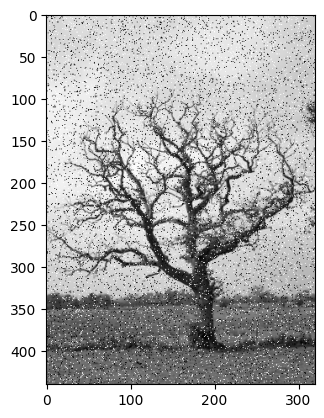

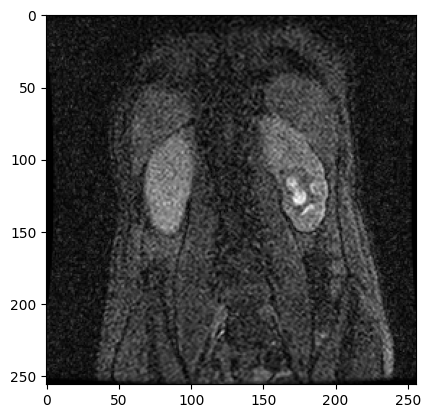

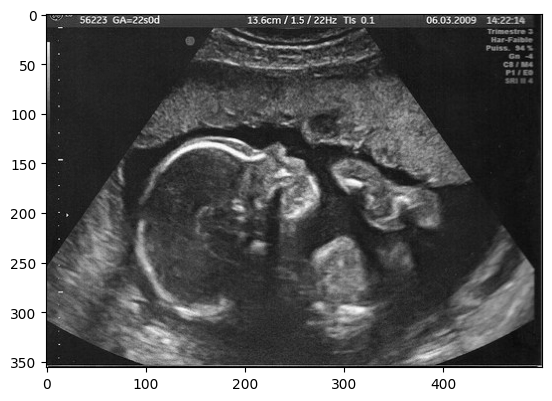

In [150]:
dts = images["Dead_tree_salt_and_pepper"]
plt.imshow(dts, cmap="gray")
plt.show()

uro = images["uro_irm"]
plt.imshow(uro, cmap="gray")
plt.show()

echo = images["echo"]
plt.imshow(echo, cmap="gray")
plt.show()

#### aplication du filtre gaussion avec different filtre

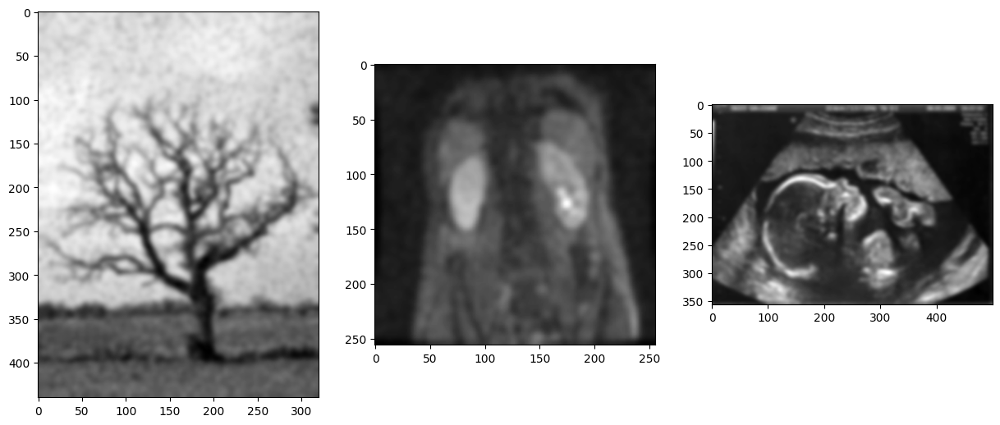

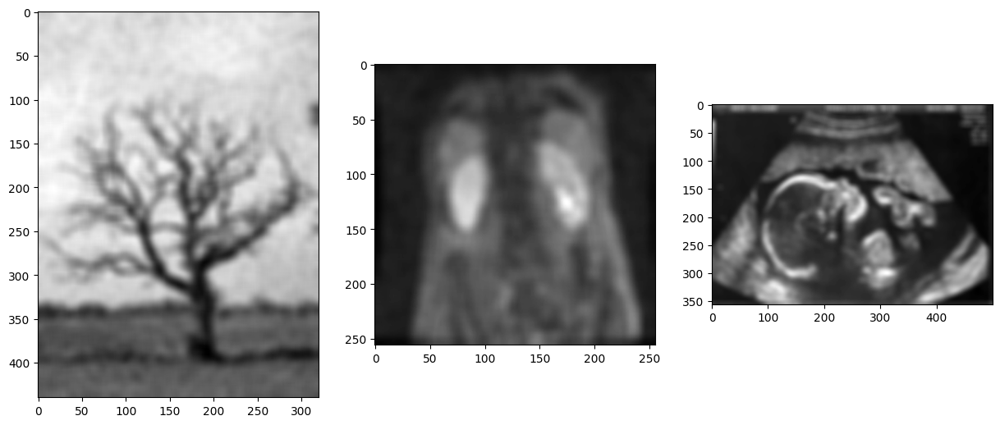

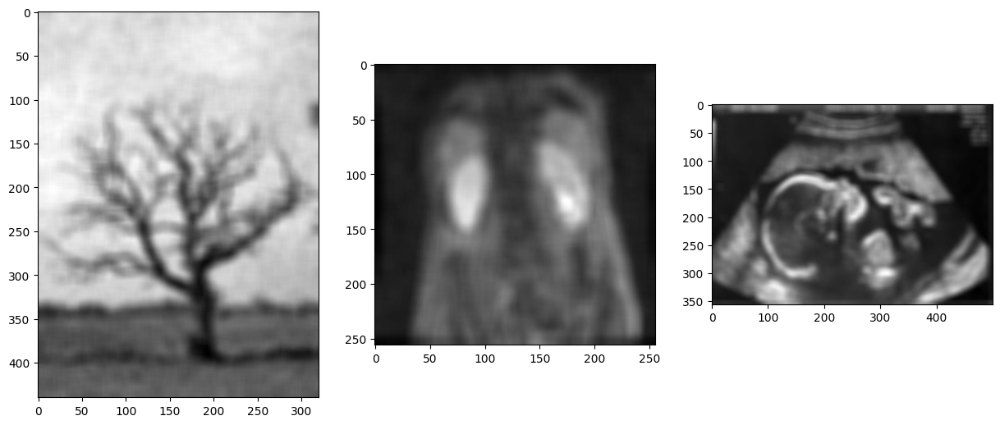

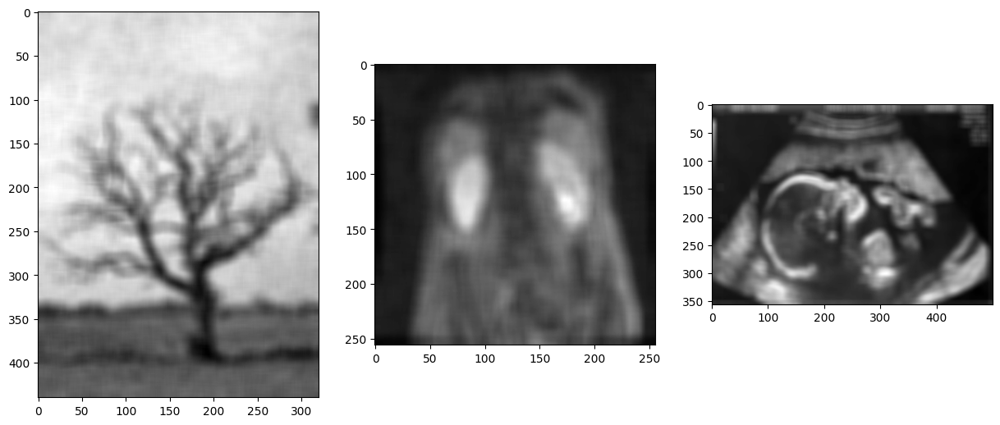

In [151]:
std_array = [3, 5, 7, 9]

for std in std_array:

    # smoothed_dts = gaussian_filter(dts, sigma=std)
    # smoothed_uro = gaussian_filter(uro, sigma=std)
    # smoothed_echo = gaussian_filter(echo, sigma=std)

    smoothed_dts = cv2.GaussianBlur(dts, (15, 15), std)
    smoothed_uro = cv2.GaussianBlur(uro, (15, 15), std)
    smoothed_echo = cv2.GaussianBlur(echo, (15, 15), std)

    plt.figure(figsize=(15, 7))
    plt.subplot(131)
    plt.imshow(smoothed_dts, cmap='gray')
    plt.subplot(132)
    plt.imshow(smoothed_uro, cmap='gray')
    plt.subplot(133)
    plt.imshow(smoothed_echo, cmap='gray')
    plt.show()

Apres avoir application du filtre gaussien avec un sigma croissant on observe que le bruit est toujours present et l'image est de plus

en plus flou.

#### aplication du filtre gaussion avec different filtre

In [152]:
help(cv2.medianBlur)

Help on built-in function medianBlur:

medianBlur(...)
    medianBlur(src, ksize[, dst]) -> dst
    .   @brief Blurs an image using the median filter.
    .   
    .   The function smoothes an image using the median filter with the \f$\texttt{ksize} \times
    .   \texttt{ksize}\f$ aperture. Each channel of a multi-channel image is processed independently.
    .   In-place operation is supported.
    .   
    .   @note The median filter uses #BORDER_REPLICATE internally to cope with border pixels, see #BorderTypes
    .   
    .   @param src input 1-, 3-, or 4-channel image; when ksize is 3 or 5, the image depth should be
    .   CV_8U, CV_16U, or CV_32F, for larger aperture sizes, it can only be CV_8U.
    .   @param dst destination array of the same size and type as src.
    .   @param ksize aperture linear size; it must be odd and greater than 1, for example: 3, 5, 7 ...
    .   @sa  bilateralFilter, blur, boxFilter, GaussianBlur



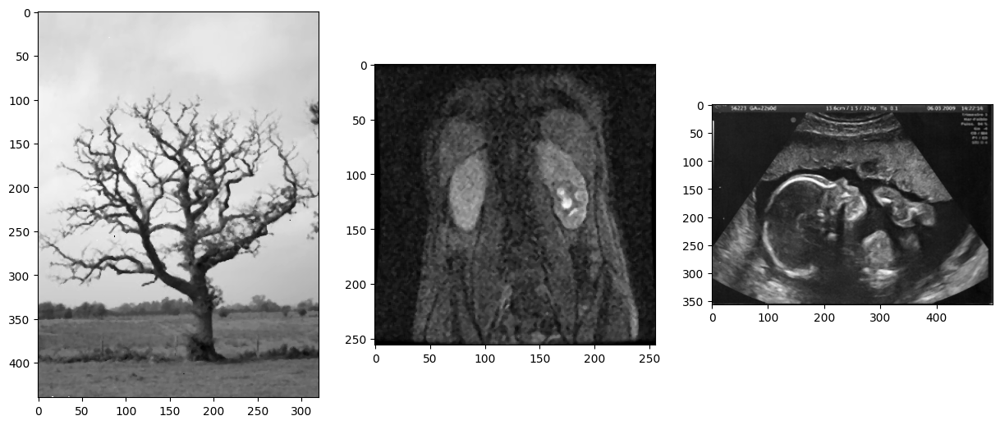

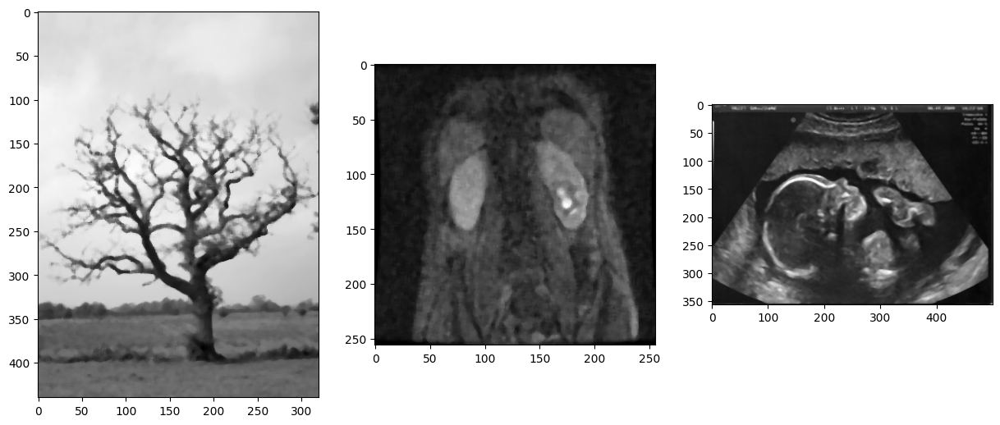

error: OpenCV(4.7.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/imgproc/src/median_blur.simd.hpp:880: error: (-215:Assertion failed) src.depth() == CV_8U && (cn == 1 || cn == 3 || cn == 4) in function 'medianBlur'


In [153]:
median_size = [3, 5, 7, 9]

for size in median_size:

    smoothed_dts = cv2.medianBlur(dts, ksize=size)
    smoothed_uro = cv2.medianBlur(uro, ksize=size)
    smoothed_echo = cv2.medianBlur(echo, ksize=size)


    plt.figure(figsize=(15, 7))
    plt.subplot(131)
    plt.imshow(smoothed_dts, cmap='gray')
    plt.subplot(132)
    plt.imshow(smoothed_uro, cmap='gray')
    plt.subplot(133)
    plt.imshow(smoothed_echo, cmap='gray')
    plt.show()

On remarque que le filtre median est beucoup plus adapter au bruit poivre et sel .

Le bruit est completement enlever.Par contre plus la taille du filtre est grande, plus 

l'image est legerement flouté et des details de l'image  disparaissent .

### 2) Appliquer un filtre gaussien avec une grande variance sur une image peu ou pas bruitée, que vous choisirez.

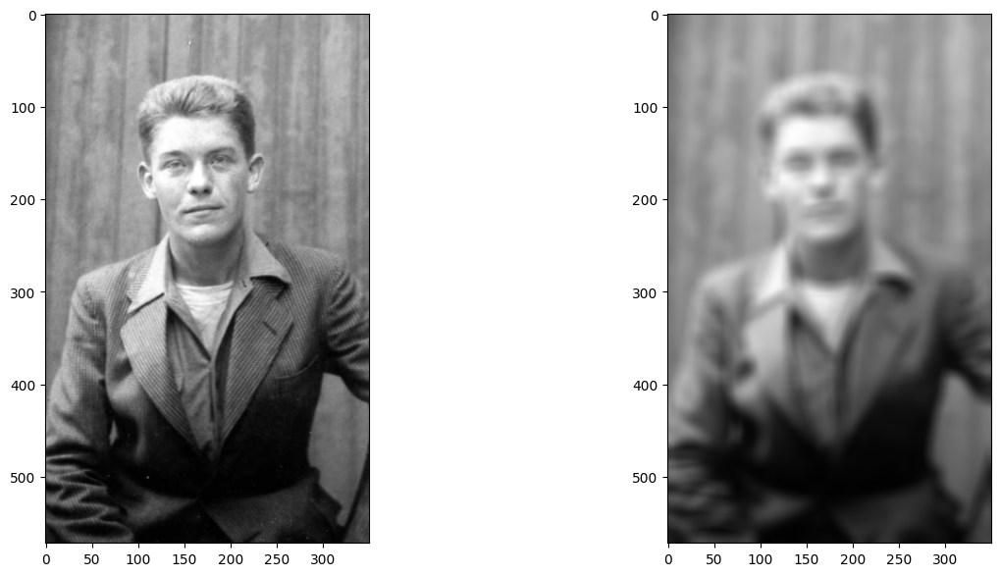

In [ ]:
ancien = images["ancien"]


high_gaussian_ancien = cv2.GaussianBlur(ancien, (15, 15), 30)


plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.imshow(ancien, cmap='gray')
plt.subplot(122)
plt.imshow(high_gaussian_ancien, cmap='gray')

plt.show()

Si on prend une grande valeur de sigma l'image sera completement flou

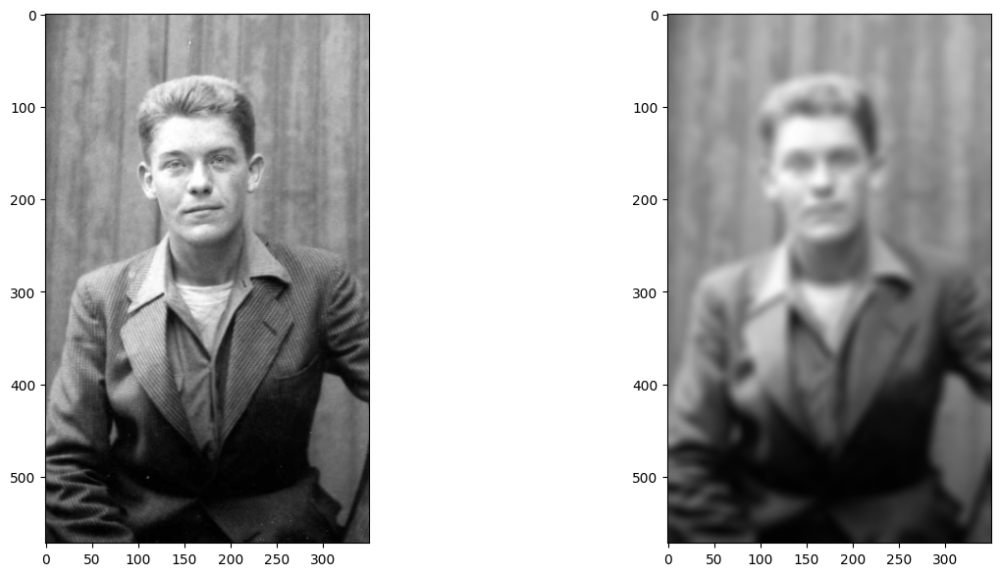

In [ ]:
ancien = images["ancien"]


low_gaussian_ancien = cv2.GaussianBlur(ancien, (15, 15), 5)


plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.imshow(ancien, cmap='gray')
plt.subplot(122)
plt.imshow(low_gaussian_ancien, cmap='gray')

plt.show()

si on applique le gaussien avec un flaible sigma : L'image est toujour floue mais beaucoup moins que tout a l'heure

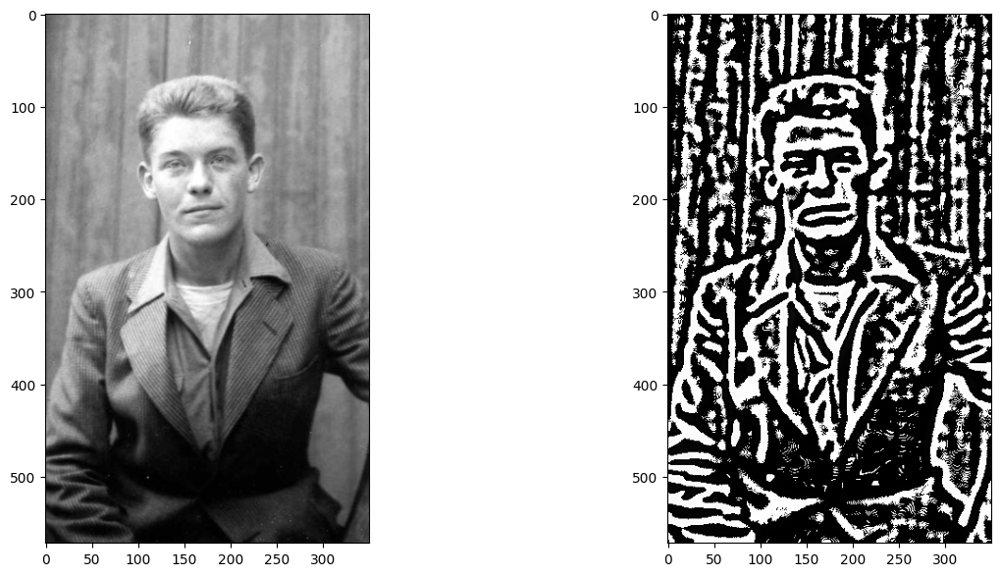

In [ ]:
DoG = high_gaussian_ancien - low_gaussian_ancien

plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.imshow(ancien, cmap='gray')
plt.subplot(122)
plt.imshow(DoG, cmap='gray')
plt.show()


on voit que le DoG rend visible les contours

## Partie II  : Détection de contours

In [ ]:
not_noised = images["lena1"]
noised = images["Dead_tree_salt_and_pepper"]

#### Appliquer un filtrage passe-haut (Sobel) pour obtenir les contours en x notés Gx et les contours en y notés Gy de l’image.

Text(0.5, 1.0, 'Gy non bruité')

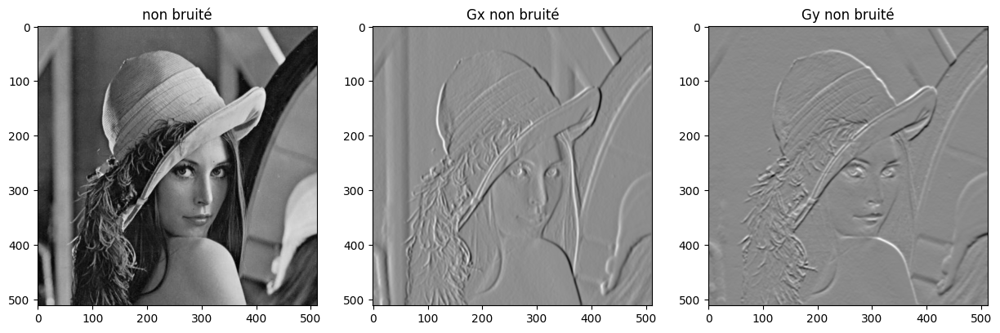

In [ ]:
not_noised_Gx = cv2.Sobel(not_noised, cv2.CV_64F, 1, 0, ksize=9)
not_noised_Gy = cv2.Sobel(not_noised, cv2.CV_64F, 0, 1, ksize=9)

plt.figure(figsize=(15, 7))
plt.subplot(131)
plt.imshow(not_noised, cmap='gray')
plt.title("non bruité")
plt.subplot(132)
plt.imshow(not_noised_Gx, cmap='gray')
plt.title("Gx non bruité")
plt.subplot(133)
plt.imshow(not_noised_Gy, cmap='gray')
plt.title("Gy non bruité")
plt.show()



Text(0.5, 1.0, 'Gy bruité')

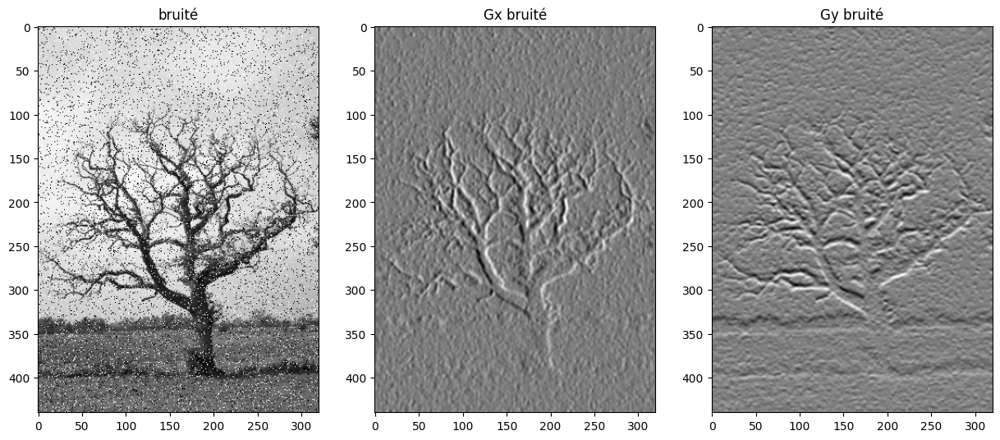

In [ ]:
noised_Gx = cv2.Sobel(noised, cv2.CV_64F, 1, 0, ksize=9)
noised_Gy = cv2.Sobel(noised, cv2.CV_64F, 0, 1, ksize=9)

plt.figure(figsize=(15, 7))
plt.subplot(131)
plt.imshow(noised, cmap='gray')
plt.title("bruité")
plt.subplot(132)
plt.imshow(noised_Gx, cmap='gray')
plt.title("Gx bruité")
plt.subplot(133)
plt.imshow(noised_Gy, cmap='gray')
plt.title("Gy bruité")
plt.show()



Text(0.5, 1.0, 'non bruité')

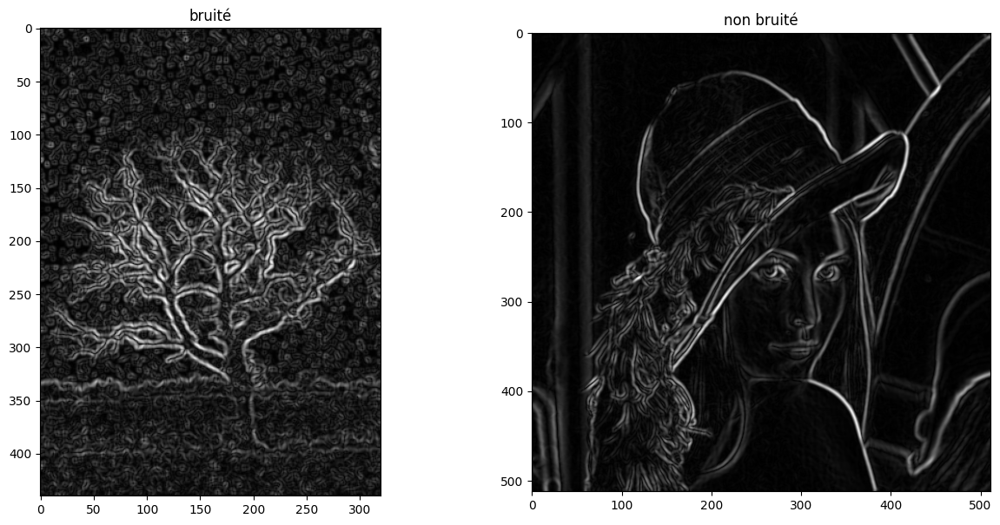

In [ ]:
noised_edge = np.abs(noised_Gx) + np.abs(noised_Gy) 
not_noised_edge = np.abs(not_noised_Gx) + np.abs(not_noised_Gy) 


plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.imshow(noised_edge, cmap='gray')
plt.title("bruité")

plt.subplot(122)
plt.imshow(not_noised_edge, cmap='gray')
plt.title("non bruité")
plt.show()


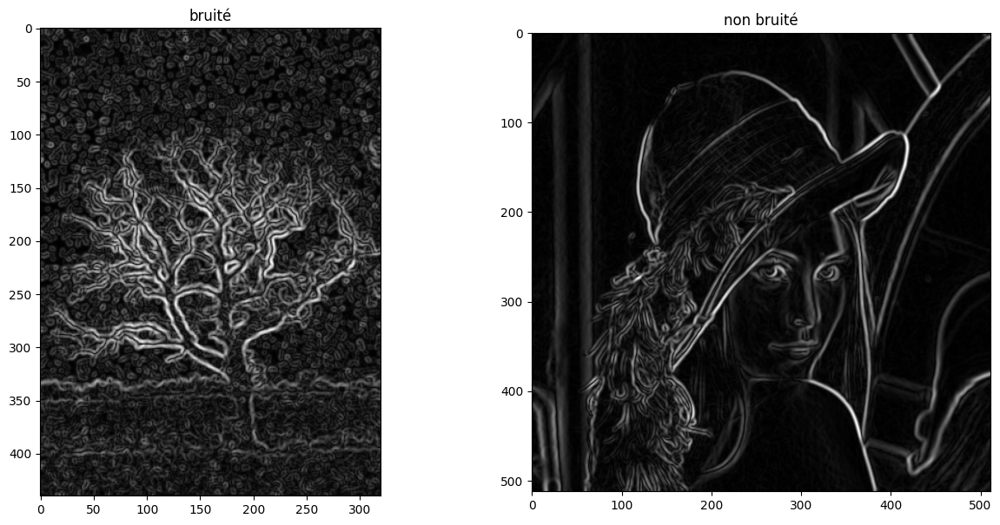

In [ ]:
noised_edge =  np.sqrt(noised_Gx**2 + noised_Gy**2) 
not_noised_edge = np.sqrt(not_noised_Gx**2 + not_noised_Gy**2) 

plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.title("bruité")
plt.imshow(noised_edge, cmap='gray')

plt.subplot(122)
plt.title("non bruité")
plt.imshow(not_noised_edge, cmap='gray')
plt.show()


Il n'a de diffrence apparante entre les resultats des deux methodes

On remarque que  Tel que soit le methode fusion utilisée (somme de valeur absolue ou norme du gradiant) le filtre Sobel met en exergue les contours mais conserve le bruit

#### 2) Appliquer la méthode de Canny pour détecter les contours. Faire varier les hyperparamètres et regarder les résultats.

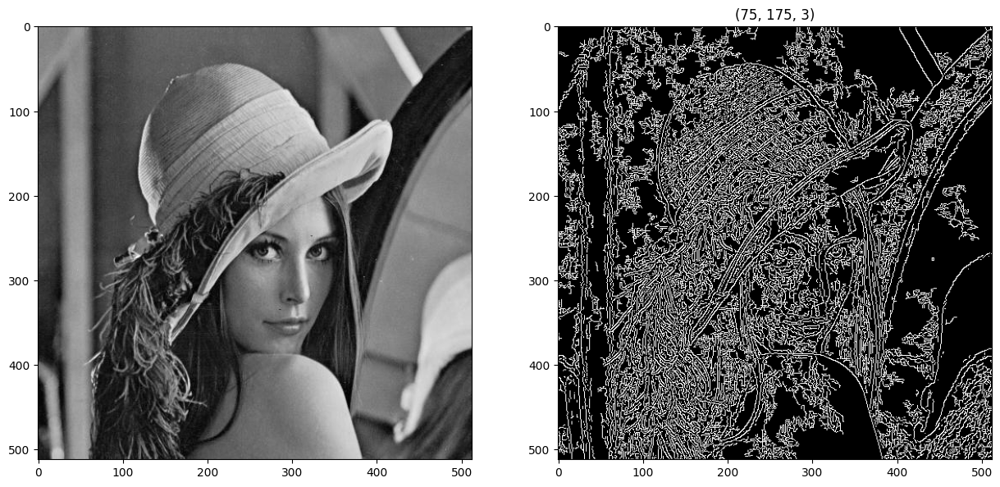

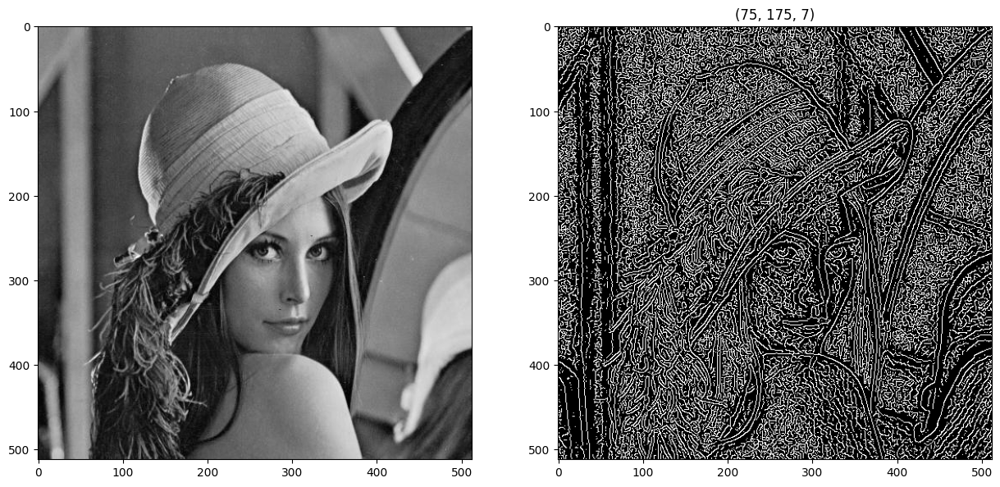

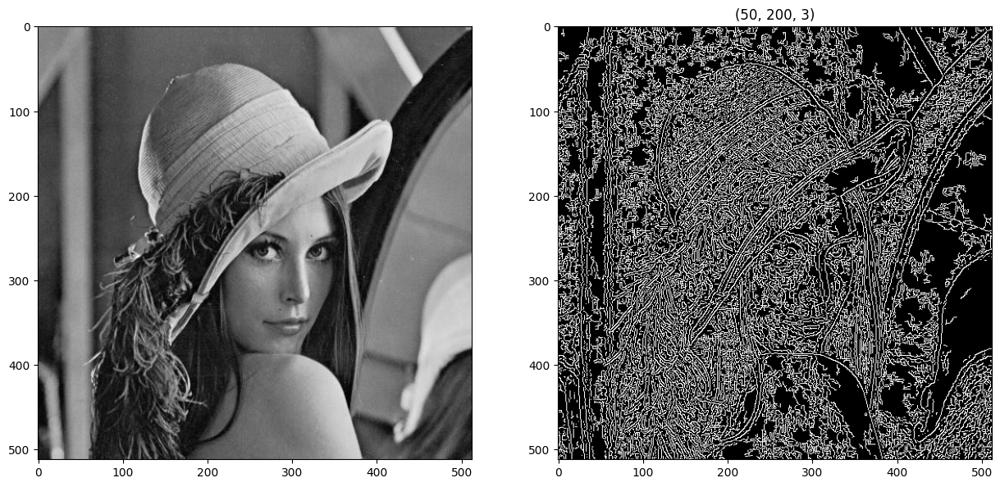

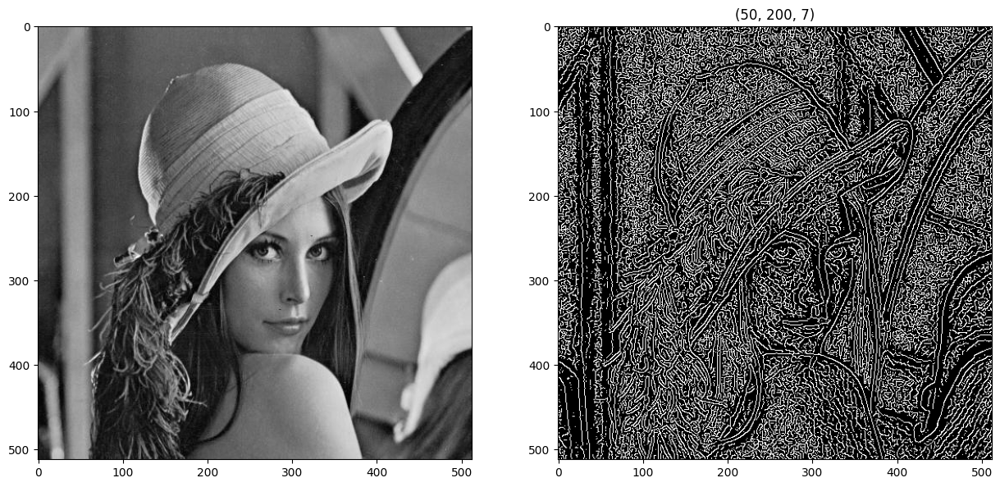

In [ ]:
parameter = [
    (75, 175, 3),
    (75, 175, 7),
    (50, 200, 3),
    (50, 200, 7)
]

for param in parameter:
    egde_not_noised = cv2.Canny(not_noised, cv2.CV_64F, param[0], param[1], apertureSize=param[2])
    plt.figure(figsize=(15, 7))
    plt.subplot(121)
    plt.imshow(not_noised, cmap='gray')
    plt.subplot(122)
    plt.imshow(egde_not_noised, cmap='gray')
    plt.title(param)


On remarque une  densite de contours plus important quand si on augmente la taille du filtre.
L'effet de l'ecart entre le seuil supperieur et le seuil inferieur n'est pas trop senti.

#### 3) Afficher le laplacien d'une image. Combiner le laplacien avec l'image originale pour réhausser les contours, comme vu en cours.

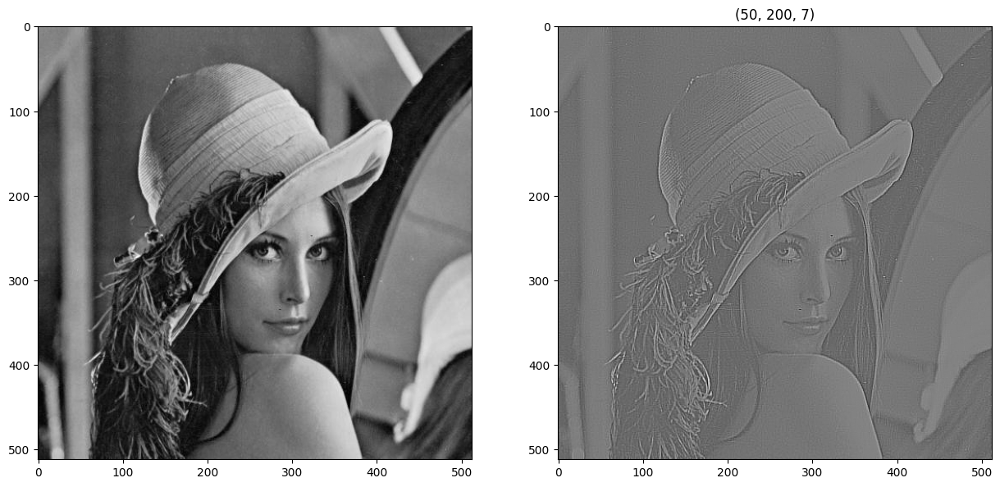

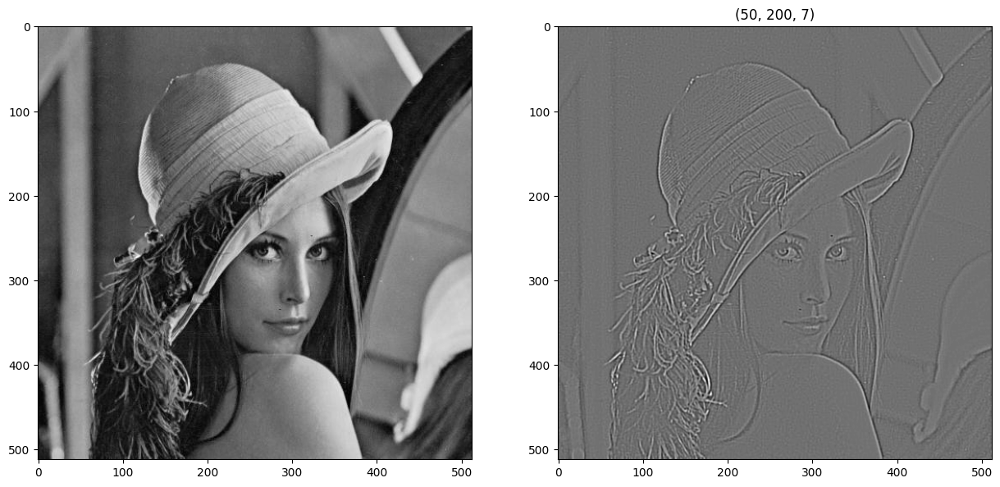

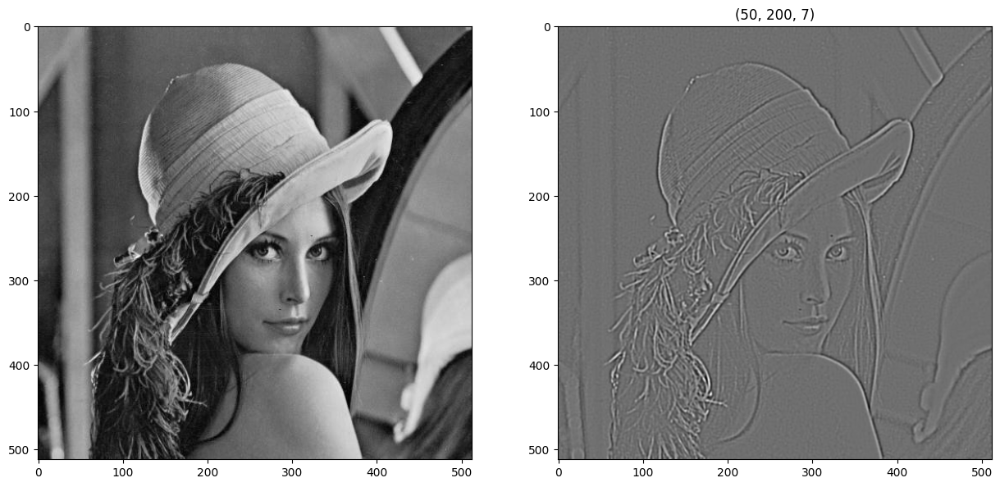

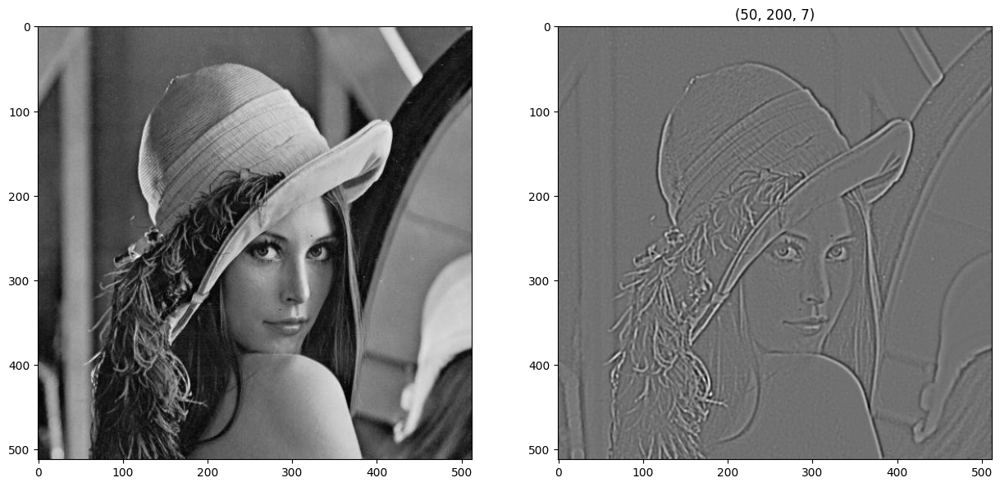

In [ ]:
for size in [3, 5, 7, 9]:
    egde_not_noised = cv2.Laplacian(not_noised,ddepth=cv2.CV_64F, ksize=size)
    plt.figure(figsize=(15, 7))
    plt.subplot(121)
    plt.imshow(not_noised, cmap='gray')
    plt.subplot(122)
    plt.imshow(not_noised - egde_not_noised, cmap='gray')
    plt.title(param)

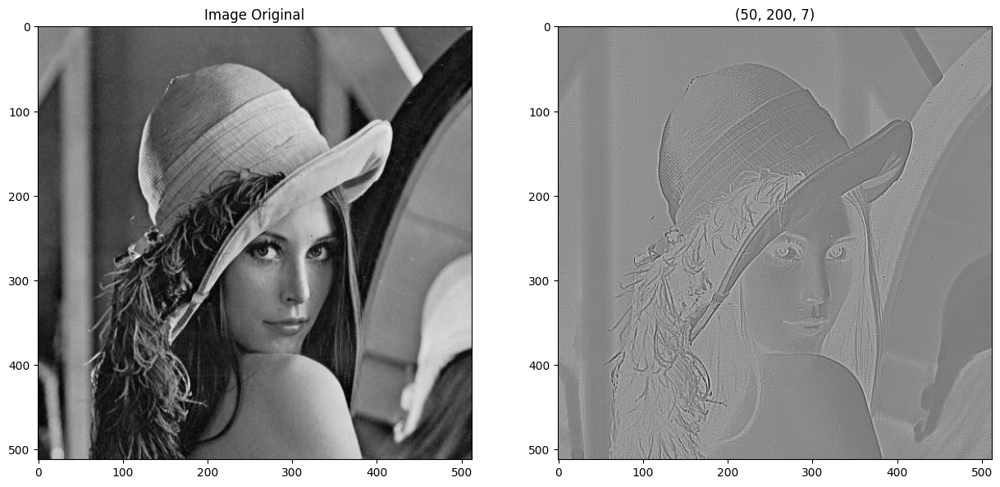

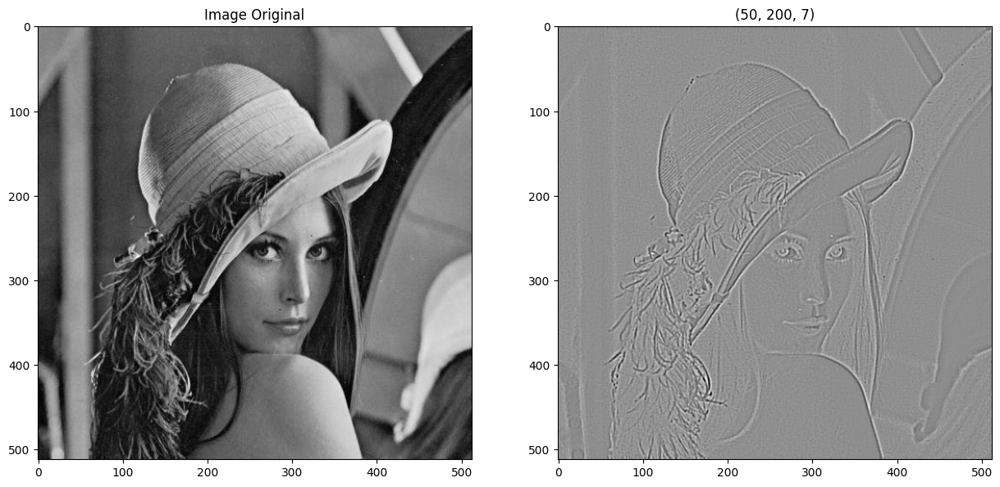

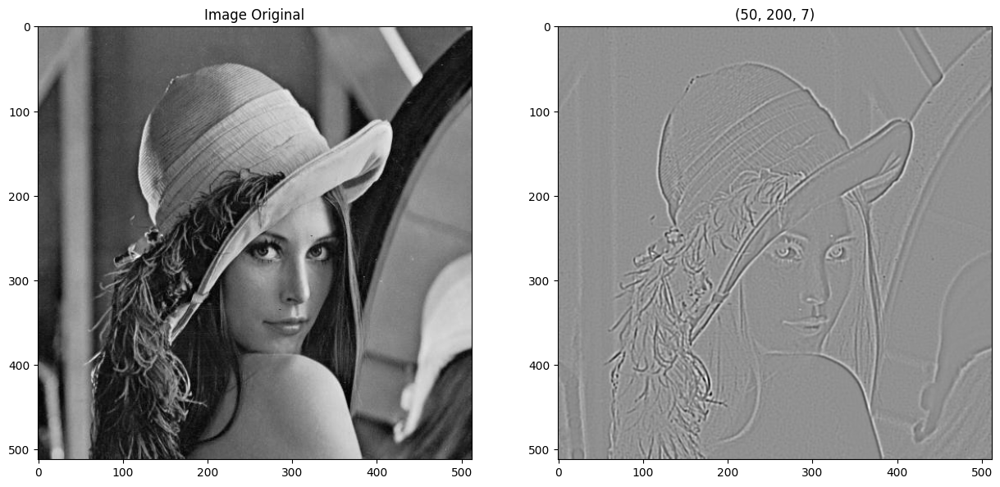

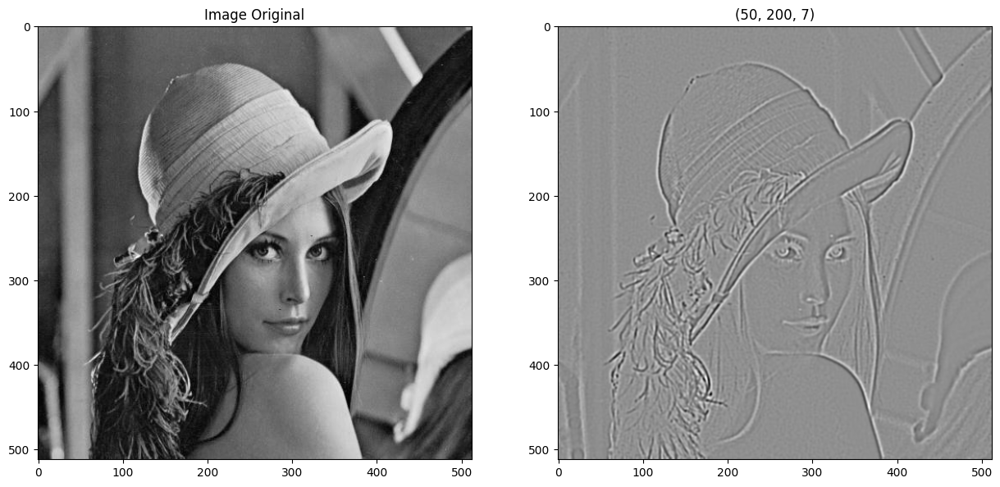

In [ ]:
for size in [3, 5, 7, 9]:
    egde_not_noised = cv2.Laplacian(not_noised,ddepth=cv2.CV_64F, ksize=size)
    plt.figure(figsize=(15, 7))
    plt.subplot(121)
    plt.title("Image Original")
    plt.imshow(not_noised, cmap='gray')
    plt.subplot(122)
    plt.title(f"contours par difference  avec le laplacien de taille {size}")
    plt.imshow(egde_not_noised - not_noised, cmap='gray')
    plt.title(param)

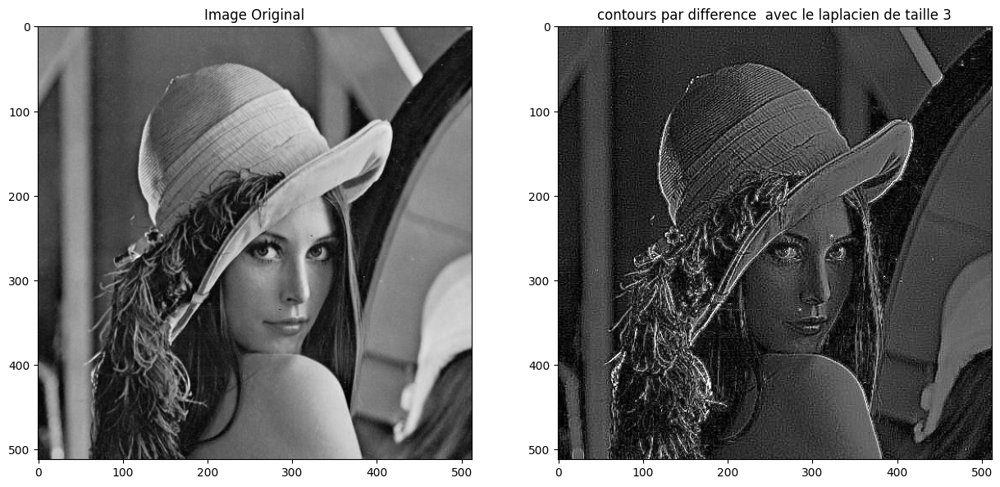

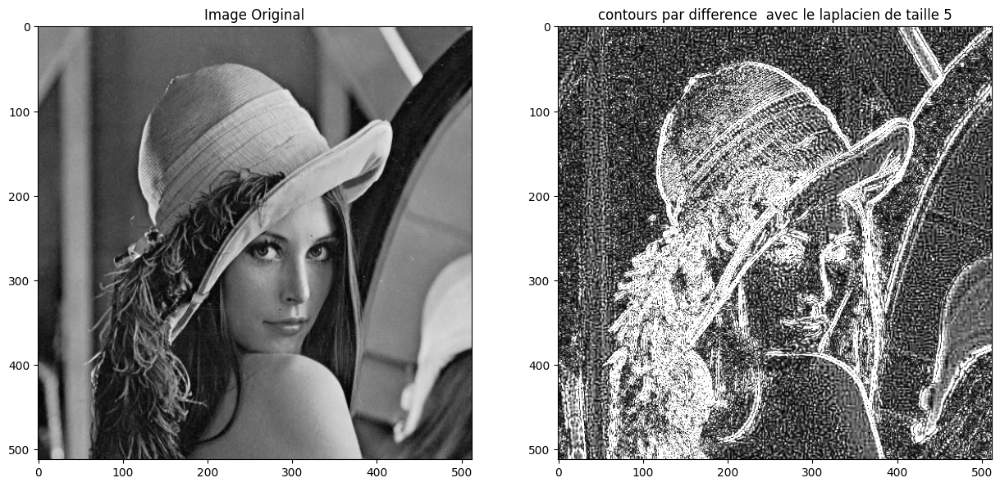

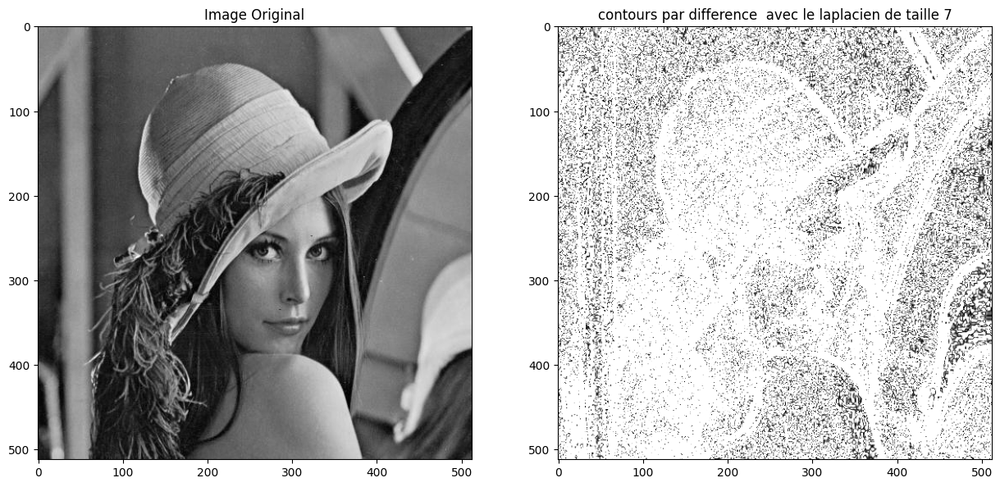

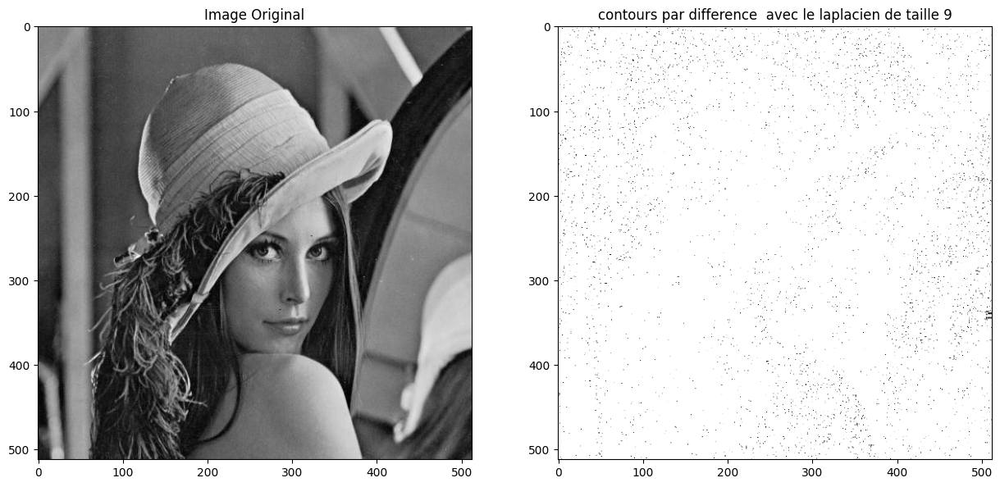

In [ ]:
for size in [3, 5, 7, 9]:
    egde_not_noised = cv2.Laplacian(not_noised,ddepth=cv2.CV_64F, ksize=size)
    plt.figure(figsize=(15, 7))
    plt.subplot(121)
    plt.title("Image Original")
    plt.imshow(not_noised, cmap='gray')
    plt.subplot(122)
    plt.title(f"contours par difference  avec le laplacien de taille {size}")
    diff = (egde_not_noised - not_noised)  * .5
    plt.imshow(cv2.convertScaleAbs(diff), cmap='gray')

Le Laplacien de taille 7 est plus adapté pour rehausser les contours

## Partie III : 

### 1) Sur l’image scanner_tete on souhaite calculer la surface occupée par les os (structure blanche). Donner la surface occupée par les os sachant que 1 pixel a pour surface 0.8mm x 0.8mm. Tracer les contours des os et les superposer en rouge sur l'image initiale.

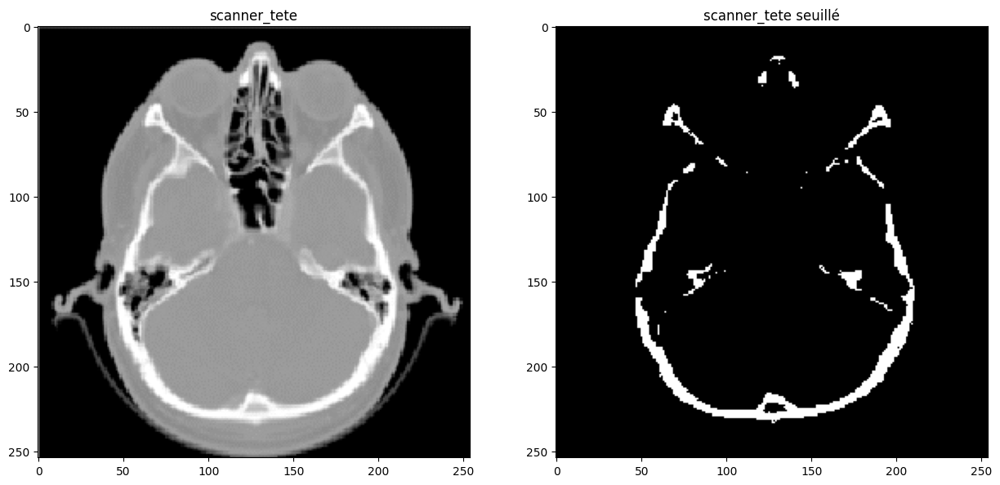

In [ ]:
scanner_tete = images["scanner_tete"]
scanner_tete_seuille = np.where(scanner_tete>=210,250,0)
plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.title("scanner_tete")
plt.imshow(scanner_tete, cmap='gray')
plt.subplot(122)
plt.title(f"scanner_tete seuillé")
plt.imshow(scanner_tete_seuille, cmap='gray')
plt.show()



In [ ]:
unit_area = 0.8**2
total_area = unit_area * np.count_nonzero(scanner_tete_seuille) #(np.sum(scanner_tete_seuille))
print("la surface occupé par les os", (total_area))


1588.4800000000002

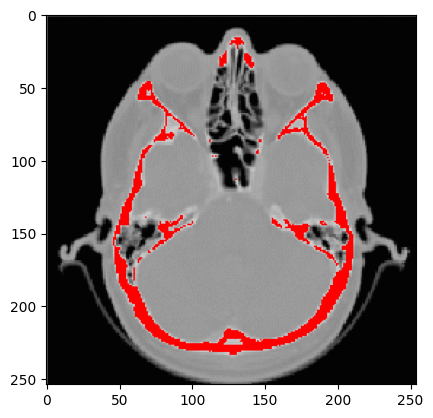

In [ ]:
bool = scanner_tete > 210
# scanner_annote *= 255

#scanner_annote = np.dstack((scanner_tete , scanner_annote, np.zeros(scanner_annote.shape)))
scanner_annote = cv2.cvtColor(scanner_tete, cv2.COLOR_GRAY2BGR)
scanner_annote[bool] = 255, 0, 0
plt.imshow(scanner_annote, cmap="gray")
plt.show()

### Restaurons l'image photocool

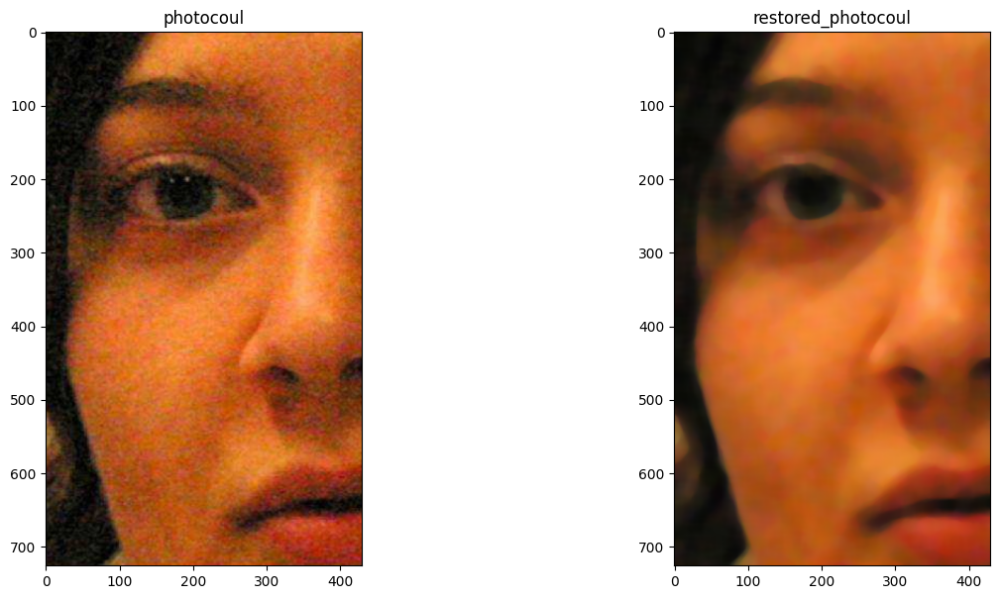

In [ ]:
photocoul = images["photocoul"]
restored_photocoul = cv2.medianBlur(photocoul, ksize=19)

plt.figure(figsize=(15, 7))
plt.subplot(121)
plt.title("photocoul")
plt.imshow(photocoul, cmap='gray')
plt.subplot(122)
plt.title(f"restored_photocoul")
plt.imshow(restored_photocoul, cmap='gray')
plt.show()